# Get resources

## Data

In [10]:
data_uri = '/Users/thorwhalen/Dropbox/py/proj/t/imbed_data_prep/misc/data/trump_vs_zelenskyy/trump_vs_zelenskyy_transcript.parquet'
embeddings_uri = '/Users/thorwhalen/Dropbox/py/proj/t/imbed_data_prep/misc/data/trump_vs_zelenskyy/trump_vs_zelenskyy_embeddings.parquet'


In [11]:
import pandas as pd
import numpy as np

data = pd.read_parquet(data_uri)
embeddings = np.vstack(pd.read_parquet(embeddings_uri)['embeddings'].values)

## Models

In [42]:
rootdir = '/Users/thorwhalen/Dropbox/Docs/Projects/mood/trump_vs_zelenskyy/data/' 


import dol 
import os

def ext_based_store(ext: str, base_store: dol.Files):
    return dol.Pipe(
        base_store,
        dol.filt_iter.suffixes(ext),
        dol.KeyCodecs.suffixed(ext),
        dol.add_ipython_key_completions
    )


basename = dol.Pipe(os.path.normpath, os.path.basename)
dirs = {basename(d): d for d in dol.DirReader(rootdir)}

import pandas as pd

import dol
import tabled

from mood.dataset_makers import parsed_lines

DatasetsStore = dol.Pipe(dol.TextFiles, dol.wrap_kvs(value_decoder=dol.Pipe(parsed_lines, pd.DataFrame)))

store_factories = {
    # 'datasets': dol.Pipe(dol.TextFiles, dol.wrap_kvs(value_decoder=parsed_lines)), #, list, pd.DataFrame),
    'datasets': ext_based_store('.txt', DatasetsStore),
    'models': ext_based_store('.pkl', dol.PickleFiles),
    'segment_score_embeddings': ext_based_store('.parquet', tabled.DfFiles),
    'model_managers': ext_based_store('.pkl', dol.PickleFiles),
    'model_stats': ext_based_store('.json', tabled.DfFiles),
}
mall = {name: store_factories[name](dirs[name]) for name in store_factories}

def model_stats_dataframe(mall=mall):
    def model_stats():
        for mood, stats in mall['model_stats'].items():
            if mood != 'emotion_despair':  # TODO: Temp fix. Address!
                t = pd.DataFrame(stats)
                t['mood'] = mood
                # move mood column to front
                t = t[['mood'] + [c for c in t.columns if c != 'mood']]
                yield t
            
    return pd.concat(model_stats(), ignore_index=True)

list(mall)


['datasets',
 'models',
 'segment_score_embeddings',
 'model_managers',
 'model_stats']

In [43]:
stats = model_stats_dataframe()
stats

,mood,model_name,data_type,n_splits,mean_squared_error,train_mean_squared_error,mean_squared_error_std,mean_absolute_error,train_mean_absolute_error,mean_absolute_error_std,r2,train_r2,r2_std
0,irony_humor,linear_regression,numerical,10.0,0.077129,0.075564,0.004439,0.237209,0.234702,0.007882,0.270059,0.286616,0.033613
1,irony_humor,svr,numerical,10.0,0.077264,0.074917,0.004838,0.230890,0.226661,0.008251,0.268392,0.292726,0.044807
2,irony_humor,ordinal_svm,ordinal,10.0,3.093757,3.084451,0.477008,1.292907,1.265154,0.099882,NaN,NaN,NaN
3,irony_humor,ordinal_forest,ordinal,10.0,1.974159,0.377987,0.097491,1.146036,0.376509,0.037323,NaN,NaN,NaN
4,topic_resource,linear_regression,numerical,10.0,0.038636,0.038098,0.001932,0.160688,0.159554,0.004274,0.653423,0.659662,0.022588
...,...,...,...,...,...,...,...,...,...,...,...,...,...
107,interpersonal_engagement,ordinal_forest,ordinal,10.0,1.008291,0.159164,0.077293,0.703111,0.158261,0.032997,NaN,NaN,NaN
108,emotion_fear,linear_regression,numerical,10.0,0.037764,0.037201,0.001332,0.156538,0.155374,0.003170,0.674359,0.680073,0.014801
109,emotion_fear,svr,numerical,10.0,0.037120,0.036402,0.001497,0.153801,0.152188,0.003254,0.679834,0.686945,0.017357
110,emotion_fear,ordinal_svm,ordinal,10.0,0.787442,0.753196,0.089044,0.502309,0.484190,0.037245,NaN,NaN,NaN


In [46]:
from pyperclip import copy

copy(stats.fillna('').to_csv())

In [48]:
import os 
import dol 

rootdir = '/Users/thorwhalen/Dropbox/Docs/Projects/mood/trump_vs_zelenskyy/data/'
managers_dir = os.path.join(rootdir, 'model_managers')
stats_dir = os.path.join(rootdir, 'model_stats')
models_dir = os.path.join(rootdir, 'models')

model_managers = dol.KeyCodecs.suffixed('.pkl')(dol.PickleFiles(managers_dir))

list(model_managers)

['military_intensity',
 'topic_resource',
 'intent_provocation',
 'gratitude_reciprocity',
 'emotion_hope',
 'hostility_confrontation',
 'topic_security',
 'emotion_pride',
 'interpersonal_engagement',
 'emotion_anger',
 'factual_speculative',
 'style_informality',
 'nationalistic_sentiment',
 'emotion_fear',
 'irony_humor',
 'style_urgency',
 'peacebroker_claim',
 'blame_attribution',
 'diplomatic_politeness',
 'sentiment_polarity',
 'historical_framing',
 'intent_persuasion',
 'moral_outrage',
 'victimhood_framing',
 'emotion_despair',
 'peace_appeal',
 'self_promotion',
 'legitimacy_appeals',
 'assertion_strength',
 'praise_admiration']

In [26]:
list(mall['model_stats'])



['irony_humor',
 'moral_outrage',
 'topic_resource',
 'peacebroker_claim',
 'emotion_pride',
 'hostility_confrontation',
 'emotion_hope',
 'emotion_despair',
 'nationalistic_sentiment',
 'sentiment_polarity',
 'emotion_anger',
 'style_urgency',
 'praise_admiration',
 'style_informality',
 'self_promotion',
 'factual_speculative',
 'historical_framing',
 'legitimacy_appeals',
 'blame_attribution',
 'military_intensity',
 'diplomatic_politeness',
 'peace_appeal',
 'intent_provocation',
 'gratitude_reciprocity',
 'topic_security',
 'assertion_strength',
 'intent_persuasion',
 'victimhood_framing',
 'interpersonal_engagement',
 'emotion_fear']

In [13]:
list(mall['model_managers'])

['military_intensity',
 'topic_resource',
 'intent_provocation',
 'gratitude_reciprocity',
 'emotion_hope',
 'hostility_confrontation',
 'topic_security',
 'emotion_pride',
 'interpersonal_engagement',
 'emotion_anger',
 'factual_speculative',
 'style_informality',
 'nationalistic_sentiment',
 'emotion_fear',
 'irony_humor',
 'style_urgency',
 'peacebroker_claim',
 'blame_attribution',
 'diplomatic_politeness',
 'sentiment_polarity',
 'historical_framing',
 'intent_persuasion',
 'moral_outrage',
 'victimhood_framing',
 'emotion_despair',
 'peace_appeal',
 'self_promotion',
 'legitimacy_appeals',
 'assertion_strength',
 'praise_admiration']

In [14]:
import itertools
from collections import defaultdict
from typing import Dict, Any
import dol

def gather_models(mall):
    for mood, manager in mall['model_managers'].items():
        for model_name, model_info in manager.final_models.items():
            model = model_info['model']
            yield mood, model_name, model 

# Using gather_models and itertools.groupby to group models by mood
# make a dict of models where models[model_name] is a dict of mood -> model
def group_models(mall: Dict[str, dol.Files]) -> Dict[str, Dict[str, Any]]:
    models_by_mood = defaultdict(lambda: defaultdict(dict))
    
    for mood, model_name, model in gather_models(mall):
        models_by_mood[model_name][mood] = model
    
    return models_by_mood


def dataframe_of_scores(model_name='logistic_high_vs_low', mall=mall):
    models = group_models(mall)
    models_for_mood = models[model_name]
    def _scores():
        for i, mood in enumerate(models_for_mood):
            model = dict(models[model_name])[mood]
            scores = model.transform(embeddings)
            yield mood, scores 
    return pd.DataFrame(dict(_scores()))

def plot_scores(mood, model_name, models, *, metadata=data, ax=None):
    from oplot.sequences import bars 

    model = dict(models[model_name])[mood]
    scores = model.transform(embeddings)
    data['scores'] = scores

    d = metadata.copy()

    d['scores'] = scores
    ax = bars(
        d, 'scores', hue='speaker', density_line=True, ax=ax,
        density_line_kwargs={
            'color': 'black', 
            'linewidth': 2,
        })
    ax.set_title(f"{mood} - {model_name}");
    ax.set_ylim(0, 1);
    return ax


In [15]:
models = group_models(mall)
list(models)

['linear_regression',
 'svr',
 'logistic_high_vs_low',
 'svm_high_vs_low',
 'ordinal_svm',
 'ordinal_forest']

In [16]:
list(models['linear_regression'])

['military_intensity',
 'topic_resource',
 'intent_provocation',
 'gratitude_reciprocity',
 'emotion_hope',
 'hostility_confrontation',
 'topic_security',
 'emotion_pride',
 'interpersonal_engagement',
 'emotion_anger',
 'factual_speculative',
 'style_informality',
 'nationalistic_sentiment',
 'emotion_fear',
 'irony_humor',
 'style_urgency',
 'peacebroker_claim',
 'blame_attribution',
 'diplomatic_politeness',
 'sentiment_polarity',
 'historical_framing',
 'intent_persuasion',
 'moral_outrage',
 'victimhood_framing',
 'emotion_despair',
 'peace_appeal',
 'self_promotion',
 'legitimacy_appeals',
 'assertion_strength',
 'praise_admiration']

In [ ]:
import pickle 

f = '/Users/thorwhalen/Dropbox/Docs/Projects/mood/trump_vs_zelenskyy/data/model_managers/emotion_despair.pkl'
with open(f, 'rb') as f:
    model_manager = pickle.load(f)
list(model_manager.final_models)

['linear_regression',
 'svr',
 'logistic_high_vs_low',
 'svm_high_vs_low',
 'ordinal_svm',
 'ordinal_forest']

In [4]:
m = models['logistic_high_vs_low']

NameError: name 'models' is not defined

In [14]:
models_for_mood = models['linear_regression']
list(models_for_mood)

['military_intensity',
 'topic_resource',
 'intent_provocation',
 'gratitude_reciprocity',
 'emotion_hope',
 'hostility_confrontation',
 'topic_security',
 'emotion_pride',
 'interpersonal_engagement',
 'emotion_anger',
 'factual_speculative',
 'style_informality',
 'nationalistic_sentiment',
 'emotion_fear',
 'irony_humor',
 'style_urgency',
 'peacebroker_claim',
 'blame_attribution',
 'diplomatic_politeness',
 'sentiment_polarity',
 'historical_framing',
 'intent_persuasion',
 'moral_outrage',
 'victimhood_framing',
 'emotion_despair',
 'peace_appeal',
 'self_promotion',
 'legitimacy_appeals',
 'assertion_strength',
 'praise_admiration']

In [11]:
model_name = 'linear_regression'

score_df = dataframe_of_scores(model_name=model_name, mall=mall)
score_df.head()

,military_intensity,topic_resource,intent_provocation,gratitude_reciprocity,emotion_hope,hostility_confrontation,topic_security,emotion_pride,interpersonal_engagement,emotion_anger,...,historical_framing,intent_persuasion,moral_outrage,victimhood_framing,emotion_despair,peace_appeal,self_promotion,legitimacy_appeals,assertion_strength,praise_admiration
0,0.552253,0.551842,0.619865,0.592466,0.598698,0.611372,0.536976,0.602291,0.614235,0.556165,...,0.579318,0.611034,0.544009,0.593492,0.606959,0.633928,0.624559,0.640921,0.665549,0.636764
1,0.581974,0.580436,0.660353,0.664460,0.676342,0.586710,0.558888,0.676355,0.642002,0.582297,...,0.590620,0.655012,0.558355,0.604569,0.542096,0.652759,0.651017,0.670057,0.654859,0.686430
2,0.562742,0.628949,0.554893,0.630255,0.686200,0.530312,0.559339,0.655776,0.587723,0.520299,...,0.549275,0.695355,0.568737,0.586161,0.582846,0.633775,0.601510,0.683219,0.738517,0.659049
3,0.479570,0.588897,0.624826,0.609895,0.631743,0.593743,0.504358,0.578022,0.596424,0.471920,...,0.529415,0.622885,0.472410,0.563325,0.551907,0.686837,0.594091,0.628737,0.668120,0.610363
4,0.537065,0.629366,0.589968,0.590810,0.586569,0.608208,0.557742,0.558751,0.575583,0.498922,...,0.567486,0.604413,0.519600,0.565523,0.561039,0.631111,0.582192,0.606913,0.646862,0.579637


In [13]:
# for i, mood in enumerate(models_for_mood):
#     plot_scores(mood, model_name, models, ax=axes[i])

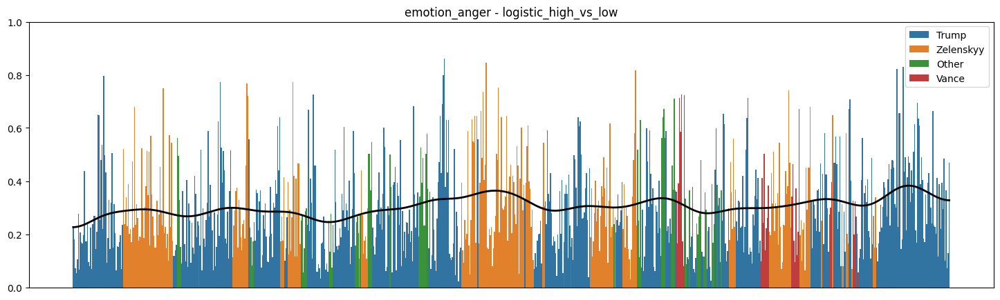

In [18]:
model_name = 'logistic_high_vs_low'
mood = 'emotion_anger'
ax = plot_scores(mood, model_name, models)

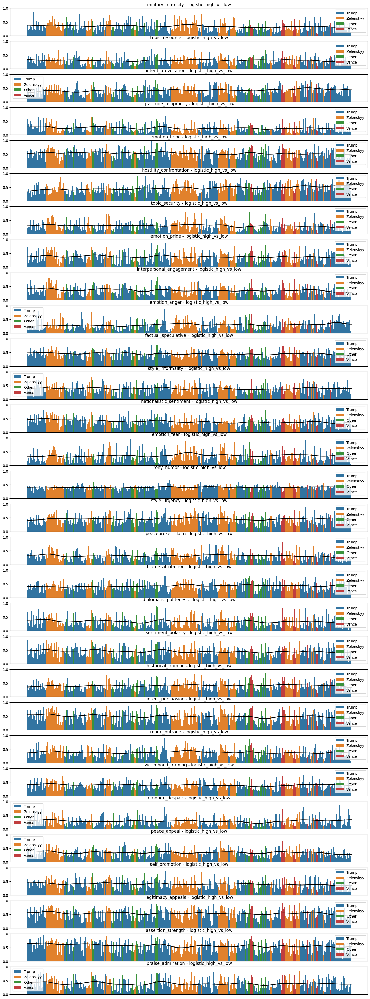

In [19]:
model_name = 'logistic_high_vs_low'
models_for_mood = models[model_name]
axes = []

import matplotlib.pyplot as plt

n = len(models_for_mood)
# Create a figure with multiple subplots
fig, axes = plt.subplots(n, 1, figsize=(18, 50), sharex=True)

import warnings

with warnings.catch_warnings():
    warnings.filterwarnings("ignore", message="Attempting to set identical low and high xlims")
    for i, mood in enumerate(models_for_mood):
        plot_scores(mood, model_name, models, ax=axes[i])


# # Adjust layout to prevent overlap
# plt.tight_layout()
# plt.show()

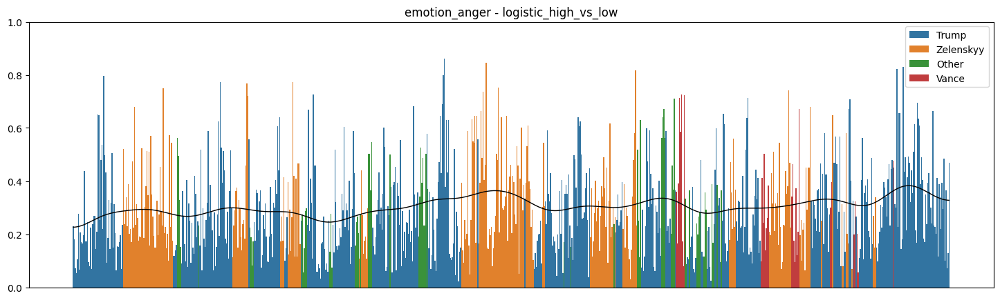

In [ ]:
mood = 'emotion_anger'
model_name = 'logistic_high_vs_low'

manager = mall['model_managers'][mood]
model = manager.final_models[model_name]['model']
scores = model.transform(embeddings)
data['scores'] = scores

from oplot.sequences import bars 

ax = bars(data, 'scores', hue='speaker', density_line=True)
ax.set_title(f"{mood} - {model_name}");
ax.set_ylim(0, 1);

In [ ]:
def plot_scores(scores, metadata):
    d = metadata.copy()
    d['scores'] = scores
    ax = bars(d, 'scores', hue='speaker', density_line=True, density_line_kwargs={'color': 'black', 'linewidth': 2})
    ax.set_title(f"{mood} - {model_name}");
    ax.set_ylim(0, 1);

In [71]:
manager = mall['model_managers']['blame_attribution']
list(manager.final_models)

['linear_regression',
 'svr',
 'logistic_high_vs_low',
 'svm_high_vs_low',
 'ordinal_svm',
 'ordinal_forest']

In [72]:
model = manager.final_models['logistic_high_vs_low']['model']
scores = model.transform(embeddings)
data['scores'] = scores

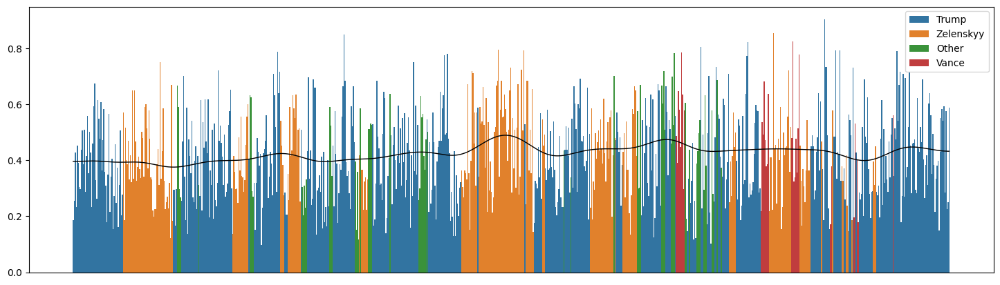

In [73]:
from oplot.sequences import bars 

ax = bars(data, 'scores', hue='speaker', density_line=True)

# Sonify dataframe

In [ ]:
# model_name = 'linear_regression'
model_name = 'logistic_high_vs_low'

# score_df = dataframe_of_scores(model_name=model_name, mall=mall)
save_file = f'trump_vs_zelenskyy_{model_name}_scores_df.parquet'
# score_df.to_parquet(save_file)
# print(f"Saved to {save_file}")
# score_df.head()

Saved to trump_vs_zelenskyy_logistic_high_vs_low_scores_df.parquet


,military_intensity,topic_resource,intent_provocation,gratitude_reciprocity,emotion_hope,hostility_confrontation,topic_security,emotion_pride,interpersonal_engagement,emotion_anger,...,historical_framing,intent_persuasion,moral_outrage,victimhood_framing,emotion_despair,peace_appeal,self_promotion,legitimacy_appeals,assertion_strength,praise_admiration
0,0.552253,0.551842,0.619865,0.592466,0.598698,0.611372,0.536976,0.602291,0.614235,0.556165,...,0.579318,0.611034,0.544009,0.593492,0.606959,0.633928,0.624559,0.640921,0.665549,0.636764
1,0.581974,0.580436,0.660353,0.664460,0.676342,0.586710,0.558888,0.676355,0.642002,0.582297,...,0.590620,0.655012,0.558355,0.604569,0.542096,0.652759,0.651017,0.670057,0.654859,0.686430
2,0.562742,0.628949,0.554893,0.630255,0.686200,0.530312,0.559339,0.655776,0.587723,0.520299,...,0.549275,0.695355,0.568737,0.586161,0.582846,0.633775,0.601510,0.683219,0.738517,0.659049
3,0.479570,0.588897,0.624826,0.609895,0.631743,0.593743,0.504358,0.578022,0.596424,0.471920,...,0.529415,0.622885,0.472410,0.563325,0.551907,0.686837,0.594091,0.628737,0.668120,0.610363
4,0.537065,0.629366,0.589968,0.590810,0.586569,0.608208,0.557742,0.558751,0.575583,0.498922,...,0.567486,0.604413,0.519600,0.565523,0.561039,0.631111,0.582192,0.606913,0.646862,0.579637


In [ ]:
# get dataframe 
import pandas as pd

score_df = pd.read_parquet('trump_vs_zelenskyy_linear_regression_scores_df.parquet')
score_df = score_df.reset_index(drop=False)
df = score_df

In [5]:
print(f"{df.shape=}")
df.iloc[0]

df.shape=(858, 31)


index                       0.000000
military_intensity          0.552253
topic_resource              0.551842
intent_provocation          0.619865
gratitude_reciprocity       0.592466
emotion_hope                0.598698
hostility_confrontation     0.611372
topic_security              0.536976
emotion_pride               0.602291
interpersonal_engagement    0.614235
emotion_anger               0.556165
factual_speculative         0.578184
style_informality           0.648250
nationalistic_sentiment     0.638273
emotion_fear                0.516896
irony_humor                 0.572416
style_urgency               0.587417
peacebroker_claim           0.589874
blame_attribution           0.521925
diplomatic_politeness       0.629611
sentiment_polarity          0.653669
historical_framing          0.579318
intent_persuasion           0.611034
moral_outrage               0.544009
victimhood_framing          0.593492
emotion_despair             0.606959
peace_appeal                0.633928
s

In [5]:
from typing import Union, Optional
from pathlib import Path
import tempfile


def convert_midi_to_wav(
    midi_path: Union[str, Path], 
    *, 
    output_path: Optional[Path] = None,
    soundfont_path: Optional[Path] = None
) -> str:
    """
    Convert a MIDI file to WAV audio using FluidSynth.
    
    Parameters
    ----------
    midi_path : str or Path
        Path to the MIDI file to convert
    output_path : Path, optional
        Path to save the generated WAV file. If None, creates a temporary file
    soundfont_path : Path, optional
        Path to a soundfont file. If None, uses default soundfont
        
    Returns
    -------
    str
        Path to the generated WAV file
    """
    try:
        import fluidsynth
    except ImportError:
        raise ImportError("Please install fluidsynth: pip install pyfluidsynth")
    
    if output_path is None:
        # Create a temporary file with .wav extension
        temp_file = tempfile.NamedTemporaryFile(suffix='.wav', delete=False)
        output_path = Path(temp_file.name)
        temp_file.close()
    
    # Use FluidSynth to convert MIDI to WAV
    fs = fluidsynth.Synth()
    
    # Load soundfont
    if soundfont_path is None:
        # Try to find a default soundfont
        default_soundfonts = [
            '/usr/share/sounds/sf2/FluidR3_GM.sf2',    # Linux
            '/usr/local/share/fluidsynth/default.sf2'  # macOS
        ]
        
        for sf_path in default_soundfonts:
            if Path(sf_path).exists():
                soundfont_path = Path(sf_path)
                break
        
        if soundfont_path is None:
            raise FileNotFoundError(
                "No soundfont found. Please provide a soundfont_path."
            )
    
    # Load soundfont
    fs.sfload(str(soundfont_path))
    
    # Render MIDI to WAV
    fs.midi_to_audio(str(midi_path), str(output_path))
    
    return str(output_path)



In [26]:
import pandas as pd
import hum 

score_df = pd.read_parquet('score_df.parquet')
score_df = score_df.reset_index(drop=False)
df = score_df
df.shape


(858, 31)

In [17]:
df.columns

Index(['index', 'military_intensity', 'topic_resource', 'intent_provocation',
       'gratitude_reciprocity', 'emotion_hope', 'hostility_confrontation',
       'topic_security', 'emotion_pride', 'interpersonal_engagement',
       'emotion_anger', 'factual_speculative', 'style_informality',
       'nationalistic_sentiment', 'emotion_fear', 'irony_humor',
       'style_urgency', 'peacebroker_claim', 'blame_attribution',
       'diplomatic_politeness', 'sentiment_polarity', 'historical_framing',
       'intent_persuasion', 'moral_outrage', 'victimhood_framing',
       'emotion_despair', 'peace_appeal', 'self_promotion',
       'legitimacy_appeals', 'assertion_strength', 'praise_admiration'],
      dtype='object')

In [9]:
from sonification.sonify_scrap import sonify_dataframe_w_astronify
import hum 


Processing 1 columns...
Pyo warning: Unknown midi type. Using Portmidi
Combining 1 sonifications...
Returning combined waveform of length 399987


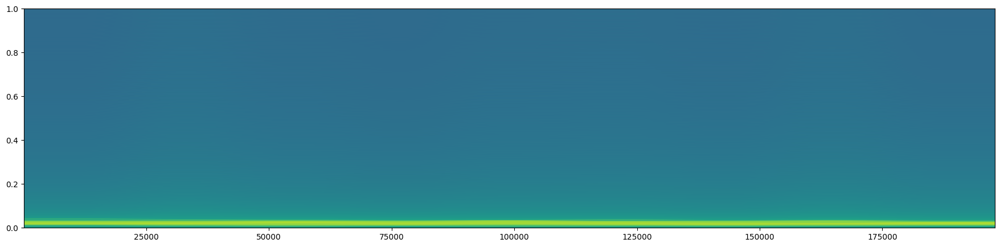

In [ ]:
# Just use a subset of columns
from sonification.sonify_scrap import sonify_dataframe_w_astronify

wf = sonify_dataframe_w_astronify(
    df, 
    time_col='index',
    pitch_cols=['military_intensity']#, 'topic_resource'] #, 'intent_provocation', 'gratitude_reciprocity']
)
hum.disp_wf(wf)

Processing 31 columns...
Pyo warning: Unknown midi type. Using Portmidi
Pyo warning: Unknown midi type. Using Portmidi
Pyo warning: Unknown midi type. Using Portmidi
Pyo warning: Unknown midi type. Using Portmidi
Pyo warning: Unknown midi type. Using Portmidi
Pyo warning: Unknown midi type. Using Portmidi
Pyo warning: Unknown midi type. Using Portmidi
Pyo warning: Unknown midi type. Using Portmidi
Pyo warning: Unknown midi type. Using Portmidi
Pyo warning: Unknown midi type. Using Portmidi
Pyo warning: Unknown midi type. Using Portmidi
Pyo warning: Unknown midi type. Using Portmidi
Pyo warning: Unknown midi type. Using Portmidi
Pyo warning: Unknown midi type. Using Portmidi
Pyo warning: Unknown midi type. Using Portmidi
Pyo warning: Unknown midi type. Using Portmidi
Pyo warning: Unknown midi type. Using Portmidi
Pyo warning: Unknown midi type. Using Portmidi
Pyo warning: Unknown midi type. Using Portmidi
Pyo warning: Unknown midi type. Using Portmidi
Pyo warning: Unknown midi type. Usi

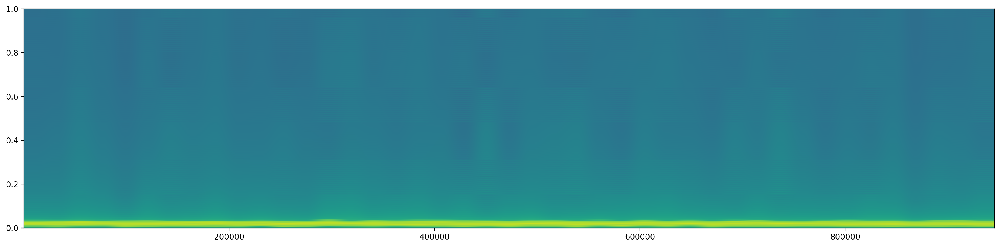

In [10]:
wf = sonify_dataframe_w_astronify(df,
                                  time_col='index',
                                  note_spacing=0.05,  # Use larger spacing between notes
                                  note_duration=0.1)  # Us

hum.disp_wf(wf)

Processing 4 columns...
Pyo warning: Unknown midi type. Using Portmidi
Pyo warning: Unknown midi type. Using Portmidi
Pyo warning: Unknown midi type. Using Portmidi
Pyo warning: Unknown midi type. Using Portmidi
Combining 4 sonifications...
Returning combined waveform of length 1894095


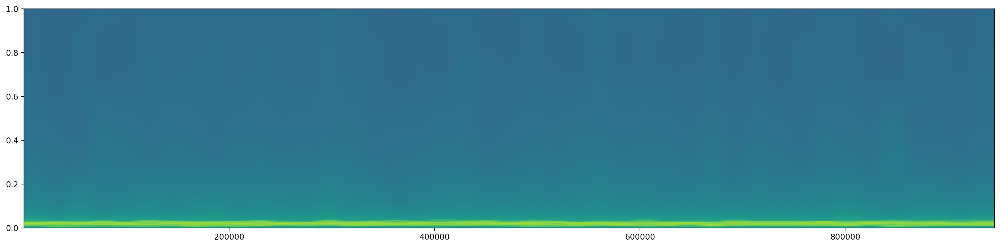

In [42]:
wf = sonify_dataframe_w_astronify(df.iloc[:, :4],
                                  time_col='index',
                                  note_spacing=0.05,  # Use larger spacing between notes
                                  note_duration=0.1)  # Us

hum.disp_wf(wf)

Processing 31 columns...
Pyo warning: Unknown midi type. Using Portmidi
Pyo warning: Unknown midi type. Using Portmidi
Pyo warning: Unknown midi type. Using Portmidi
Pyo warning: Unknown midi type. Using Portmidi
Pyo warning: Unknown midi type. Using Portmidi
Pyo warning: Unknown midi type. Using Portmidi
Pyo warning: Unknown midi type. Using Portmidi
Pyo warning: Unknown midi type. Using Portmidi
Pyo warning: Unknown midi type. Using Portmidi
Pyo warning: Unknown midi type. Using Portmidi
Pyo warning: Unknown midi type. Using Portmidi
Pyo warning: Unknown midi type. Using Portmidi
Pyo warning: Unknown midi type. Using Portmidi
Pyo warning: Unknown midi type. Using Portmidi
Pyo warning: Unknown midi type. Using Portmidi
Pyo warning: Unknown midi type. Using Portmidi
Pyo warning: Unknown midi type. Using Portmidi
Pyo warning: Unknown midi type. Using Portmidi
Pyo warning: Unknown midi type. Using Portmidi
Pyo warning: Unknown midi type. Using Portmidi
Pyo warning: Unknown midi type. Usi

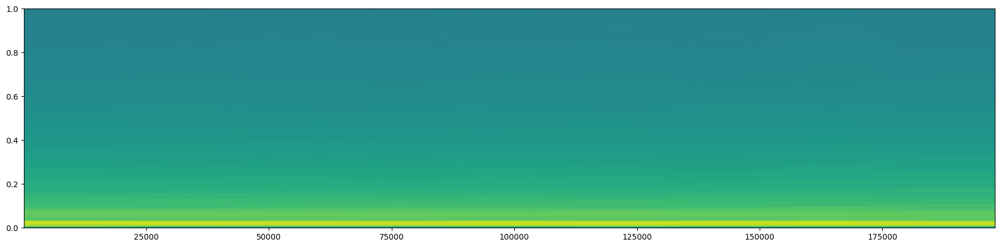

In [ ]:
wf = sonify_dataframe_w_astronify(df, time_col='index', waveform_type='triangle', )
hum.disp_wf(wf)

In [5]:
import numpy as np
from astropy.table import Table
from pyo import *

def sonify_semantic_attributes(data, time_col='index', emotion_col='emotion_anger', 
                              intensity_col='military_intensity', polarity_col='sentiment_polarity'):
    """
    Sonifies semantic attributes from text data, focusing on emotion, intensity, and polarity.

    Args:
        data (Table): Astropy Table with semantic attribute data.
        time_col (str): Column name for the time-like index.
        emotion_col (str): Column name for the emotion (e.g., anger) scores.
        intensity_col (str): Column name for intensity (e.g., military intensity).
        polarity_col (str): Column name for sentiment polarity.

    Returns:
        Server: The pyo Server instance. (The audio plays directly)
    """

    s = Server().boot()  # Initialize the pyo server

    # --- Data Normalization and Scaling ---
    # Normalize to 0-1 range (if not already) and scale to useful ranges
    emotion = np.array(data[emotion_col])
    emotion = (emotion - np.min(emotion)) / (np.max(emotion) - np.min(emotion)) # Normalize 0-1
    emotion = emotion * 0.8  # Scale to 0-0.8 for parameter influence

    intensity = np.array(data[intensity_col])
    intensity = (intensity - np.min(intensity)) / (np.max(intensity) - np.min(intensity))
    intensity = intensity * 0.5  # Scale for parameter influence

    polarity = np.array(data[polarity_col])
    polarity = (polarity - np.min(polarity)) / (np.max(polarity) - np.min(polarity))
    polarity = (polarity * 2) - 1 # Rescale from 0-1 to -1 to 1

    time_values = np.array(data[time_col])
    time_values = (time_values - np.min(time_values)) / (np.max(time_values) - np.min(time_values))
    time_values = time_values * 5 # Scale to a reasonable duration (e.g., 5 seconds)


    # --- Sound Synthesis Parameters (Expressive Mapping) ---

    # 1. Pitch (Emotion & Polarity)
    base_freq = 220  # Base frequency
    pitch_variation = emotion * 500 + np.abs(polarity) * 200 # More variation for emotion, polarity
    freqs = base_freq + pitch_variation

    # 2. Dissonance (Emotion)
    # Use detuned oscillators to create dissonance
    detune_amounts = emotion * 12  # Up to 12 semitones detuning
    
    # 3. Amplitude Envelope (Intensity)
    attack_times = 0.01 + intensity * 0.2  # Short attack, modulated by intensity
    decay_times = 0.1 + intensity * 0.5    # Longer decay, also modulated by intensity
    
    # 4. Distortion (Emotion & Intensity)
    distortion_factors = emotion + intensity * 0.5 # More distortion for high emotion/intensity
    
    # 5. Tempo / Timing
    base_tempo = 120 # Base BPM
    tempo_changes = emotion * 60 # Faster for higher emotion
    durations = 0.2 + tempo_changes/base_tempo # Note Durations

    # --- Sound Objects (pyo) ---
    aenv = []
    a1 = []
    dist = []
    
    for i in range(len(data)):
        # Frequency
        freq = freqs[i]
        
        # Dissonance
        osc1 = Osc(freq,  mul=0.5)
        osc2 = Osc(freq * pow(2, detune_amounts[i] / 12.0), mul=0.5) # Detuned oscillator

        # Amplitude Envelope
        env = Adsr(attack=attack_times[i], decay=decay_times[i], sustain=0.5, release=0.1, mul=0.3)
        aenv.append(env)
        
        # Sum oscillators
        sum_osc = (osc1 + osc2) * env

        # Distortion
        dist_amt = distortion_factors[i] * 0.8
        dist_sig = Disto(sum_osc, drive=dist_amt, slope=0.8)
        dist.append(dist_sig)
        
        # Output
        out_sig = dist_sig.out(delay=time_values[i])
        a1.append(out_sig)

    s.start()
    s.gui(locals()) # Open the Pyo GUI to see the signal flow and parameters
    return s


if __name__ == '__main__':
    # --- Example Usage ---
    # Create dummy data (replace with your actual data)
    num_points = 200
    index = np.arange(num_points)
    emotion_anger = np.random.rand(num_points)
    military_intensity = np.random.rand(num_points)
    sentiment_polarity = np.random.uniform(-1, 1, num_points)

    data = Table({
        'index': index,
        'emotion_anger': emotion_anger,
        'military_intensity': military_intensity,
        'sentiment_polarity': sentiment_polarity
    })

    # Sonify the data
    server = sonify_semantic_attributes(data, time_col='index', 
                                   emotion_col='emotion_anger', 
                                   intensity_col='military_intensity', 
                                   polarity_col='sentiment_polarity')

Pyo warning: Portaudio input device `MacBook Pro Microphone` has fewer channels (1) than requested (2).


PyoArgumentTypeError: bad argument at position 0 to "Osc" (PyoTableObject expected, got <class 'numpy.float64'>)

In [23]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

# Create sample data
df = pd.DataFrame({
    'time': np.linspace(0, 10, 100),
    'sine': np.sin(np.linspace(0, 10, 100)),
    'cos': np.cos(np.linspace(0, 10, 100))
})

# Get the combined waveform (default waveform type is sine)
waveform = sonify_dataframe_w_astronify(df, time_col='time')

# Try different waveform types
square_wave = sonify_dataframe_w_astronify(
    df, 
    time_col='time', 
    waveform_type='square'
)

# Change other parameters
custom_wave = sonify_dataframe_w_astronify(
    df, 
    time_col='time',
    note_spacing=0.05,  # more space between notes
    note_duration=0.3,  # shorter notes
    gain=0.08,          # slightly louder
    waveform_type='triangle'
)

# Save to a file
sonify_dataframe_w_astronify(
    df, 
    time_col='time',
    egress='my_sonification.wav'
)

# Get individual sonifications
sonifications = sonify_dataframe_w_astronify(
    df, 
    time_col='time',
    combine=False
)

# Access individual waveforms
sine_wave = sonifications['sine']['waveform']
pitch_values = sonifications['sine']['pitch_values']

Pyo warning: Unknown midi type. Using Portmidi
Pyo warning: Unknown midi type. Using Portmidi
Error generating sonification for column sine: The Server must be booted before creating any audio object.
Pyo message: Offline Server rendering file /var/folders/mc/c070wfh51kxd9lft8dl74q1r0000gn/T/tmp32vutkyb.wav dur=1.490000
Pyo message: Offline Server rendering finished.


TypeError: sonify_dataframe_w_astronify() got an unexpected keyword argument 'waveform_type'

In [1]:
# Print column dtypes
print(f"{df.shape=}")
print(df.iloc[0])
# print(df.dtypes)

NameError: name 'df' is not defined

In [ ]:
# Print column dtypes
# print(df.dtypes)

index                         int64
military_intensity          float64
topic_resource              float64
intent_provocation          float64
gratitude_reciprocity       float64
emotion_hope                float64
hostility_confrontation     float64
topic_security              float64
emotion_pride               float64
interpersonal_engagement    float64
emotion_anger               float64
factual_speculative         float64
style_informality           float64
nationalistic_sentiment     float64
emotion_fear                float64
irony_humor                 float64
style_urgency               float64
peacebroker_claim           float64
blame_attribution           float64
diplomatic_politeness       float64
sentiment_polarity          float64
historical_framing          float64
intent_persuasion           float64
moral_outrage               float64
victimhood_framing          float64
emotion_despair             float64
peace_appeal                float64
self_promotion              

Pyo warning: Unknown midi type. Using Portmidi
Pyo warning: Unknown midi type. Using Portmidi
Pyo warning: Unknown midi type. Using Portmidi
Pyo warning: Unknown midi type. Using Portmidi
Pyo warning: Unknown midi type. Using Portmidi
Pyo warning: Unknown midi type. Using Portmidi
Pyo warning: Unknown midi type. Using Portmidi
Pyo warning: Unknown midi type. Using Portmidi
Pyo warning: Unknown midi type. Using Portmidi
Pyo warning: Unknown midi type. Using Portmidi
Pyo warning: Unknown midi type. Using Portmidi
Pyo warning: Unknown midi type. Using Portmidi
Pyo warning: Unknown midi type. Using Portmidi
Pyo warning: Unknown midi type. Using Portmidi
Pyo warning: Unknown midi type. Using Portmidi
Pyo warning: Unknown midi type. Using Portmidi
Pyo warning: Unknown midi type. Using Portmidi
Pyo warning: Unknown midi type. Using Portmidi
Pyo warning: Unknown midi type. Using Portmidi
Pyo warning: Unknown midi type. Using Portmidi
Pyo warning: Unknown midi type. Using Portmidi
Pyo warning: 

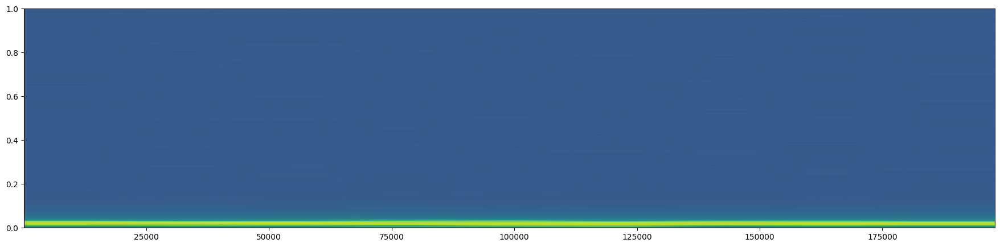

In [11]:

# Get the combined waveform without saving
wf = sonify_dataframe_w_astronify(df, time_col='index')
import hum
hum.disp_wf(wf)

Error generating sonification for column sine: The Server must be booted before creating any audio object.
Pyo message: Offline Server rendering file /var/folders/mc/c070wfh51kxd9lft8dl74q1r0000gn/T/tmpugc8qhlr.wav dur=1.490000
Pyo message: Offline Server rendering finished.


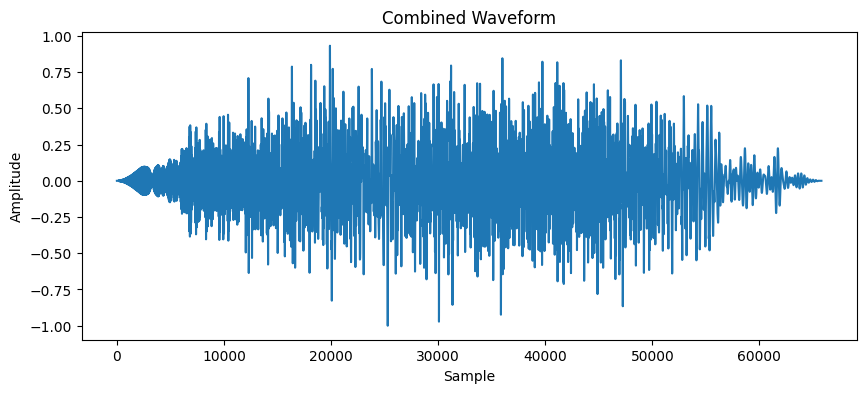

Error generating sonification for column sine: The Server must be booted before creating any audio object.
Pyo message: Offline Server rendering file /var/folders/mc/c070wfh51kxd9lft8dl74q1r0000gn/T/tmp4n7nst47.wav dur=1.490000
Pyo message: Offline Server rendering finished.


array([0., 0., 0., ..., 0., 0., 0.])

In [21]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

# Create sample data
df = pd.DataFrame({
    'time': np.linspace(0, 10, 100),
    'sine': np.sin(np.linspace(0, 10, 100)),
    'cos': np.cos(np.linspace(0, 10, 100))
})

# Get the combined waveform without saving
waveform = sonify_dataframe_w_astronify(df, time_col='time')

# Visualize the waveform
plt.figure(figsize=(10, 4))
plt.plot(waveform)
plt.title('Combined Waveform')
plt.xlabel('Sample')
plt.ylabel('Amplitude')
plt.show()

# Save the combined waveform to a file
sonify_dataframe_w_astronify(
    df, 
    time_col='time',
    egress='my_combined_sound.wav'
)

In [17]:
from hum import Sound

a = Sound.from_file('my_combined_sound.wav')
a.hear()

In [1]:
from astronify.series import SoniSeries
from astropy.table import Table

data_table = Table({"time":[0, 1, 2, 3, 4, 5, 9, 10, 11, 12],
                    "flux": [0.3, 0.4, 0.3, 0.5, 0.5, 0.4, 0.3, 0.2, 0.3, 0.1]})

data_soni = SoniSeries(data_table)
data_soni.note_spacing = 0.2
data_soni.sonify()

In [2]:
data_soni.play()

Pyo warning: Portaudio input device `MacBook Pro Microphone` has fewer channels (1) than requested (2).


In [4]:
# add /Users/thorwhalen/Dropbox/py/proj/forks/astronify to python path
import sys
sys.path.append('/Users/thorwhalen/Dropbox/py/proj/forks/astronify')

from astronify.series import SoniSeries
from astropy.table import Table

data_table = Table({"time":[0, 1, 2, 3, 4, 5, 9, 10, 11, 12],
                    "flux": [0.3, 0.4, 0.3, 0.5, 0.5, 0.4, 0.3, 0.2, 0.3, 0.1]})

data_soni = SoniSeries(data_table)
data_soni.note_spacing = 0.2
data_soni.sonify()
data_soni.play_notebook()


In [ ]:
data_soni.play_notebook()

'/Users/thorwhalen/.pyenv/versions/3.10.13/envs/p10/src/astronify/astronify/__init__.py'

In [4]:
data_soni.sonify()
data_soni.play()
data_soni.sonify()


In [7]:
data_soni.play()

In [3]:
data_soni.play()

In [11]:
data_soni = SoniSeries(Table.from_pandas(df), time_col='index', val_col='emotion_despair')
data_soni.note_spacing = 0.2
data_soni.sonify()

In [12]:
data_soni.play()

Pyo warning: Portaudio input device `MacBook Pro Microphone` has fewer channels (1) than requested (2).


# Scrap: Looking at models stats

In [ ]:
rootdir = '/Users/thorwhalen/Dropbox/Docs/Projects/mood/trump_vs_zelenskyy/data/' 


import dol 
import os

def ext_based_store(ext: str, base_store: dol.Files):
    return dol.Pipe(
        base_store,
        dol.filt_iter.suffixes(ext),
        dol.KeyCodecs.suffixed(ext),
        dol.add_ipython_key_completions
    )


basename = dol.Pipe(os.path.normpath, os.path.basename)
dirs = {basename(d): d for d in dol.DirReader(rootdir)}

import pandas as pd

import dol
import tabled

from mood.dataset_makers import parsed_lines

DatasetsStore = dol.Pipe(dol.TextFiles, dol.wrap_kvs(value_decoder=dol.Pipe(parsed_lines, pd.DataFrame)))

store_factories = {
    # 'datasets': dol.Pipe(dol.TextFiles, dol.wrap_kvs(value_decoder=parsed_lines)), #, list, pd.DataFrame),
    'datasets': ext_based_store('.txt', DatasetsStore),
    'models': ext_based_store('.pkl', dol.PickleFiles),
    'segment_score_embeddings': ext_based_store('.parquet', tabled.DfFiles),
    'model_managers': ext_based_store('.pkl', dol.PickleFiles),
    'model_stats': ext_based_store('.json', tabled.DfFiles),
}
mall = {name: store_factories[name](dirs[name]) for name in store_factories}
list(mall)


['datasets',
 'models',
 'segment_score_embeddings',
 'model_managers',
 'model_stats']

In [33]:
for k in mall:
    if k == 'models':
        continue
    store = mall[k]
    store['irony_humor']

In [35]:
model_stats = mall['model_stats']
for k, stats in model_stats.items():
    break
stats


,model_name,data_type,n_splits,mean_squared_error,train_mean_squared_error,mean_squared_error_std,mean_absolute_error,train_mean_absolute_error,mean_absolute_error_std,r2,train_r2,r2_std
0,linear_regression,numerical,10,0.077129,0.075564,0.004439,0.237209,0.234702,0.007882,0.270059,0.286616,0.033613
1,svr,numerical,10,0.077264,0.074917,0.004838,0.230890,0.226661,0.008251,0.268392,0.292726,0.044807
2,ordinal_svm,ordinal,10,3.093757,3.084451,0.477008,1.292907,1.265154,0.099882,NaN,NaN,NaN
3,ordinal_forest,ordinal,10,1.974159,0.377987,0.097491,1.146036,0.376509,0.037323,NaN,NaN,NaN


In [38]:
manager = mall['model_managers']['irony_humor']
list(manager.final_models)

['linear_regression',
 'svr',
 'logistic_high_vs_low',
 'svm_high_vs_low',
 'ordinal_svm',
 'ordinal_forest']

In [39]:
manager.final_models['linear_regression']

{'model': MoodEstimator(max_dims=50, model=Ridge()),
 'full_data_metrics': {'mse': 0.07547608806763034,
  'rmse': 0.2747291176188471,
  'mae': 0.23431637756029686,
  'r2': 0.2874765710230669,
  'spearman': 0.521935549444254,
  'kendall_tau': 0.39229836310083543,
  'min_pred': -0.062494728648123,
  'max_pred': 0.921046020601152,
  'min_mood': 0.4843814008289483,
  'max_mood': 0.715255191657801}}

In [40]:
manager.final_models['logistic_high_vs_low']

{'model': MoodEstimator(max_dims=50, model=LogisticRegression(class_weight='balanced')),
 'full_data_metrics': {'accuracy': 0.6541019955654102,
  'precision': 0.6125202374527793,
  'recall': 0.6816816816816816,
  'f1': 0.6452529846503695,
  'auc': 0.7229129283684096,
  'tn': 1225,
  'fp': 718,
  'fn': 530,
  'tp': 1135}}

In [43]:
manager.final_models['ordinal_svm']

{'model': MoodEstimator(max_dims=50,
               model=SVC(decision_function_shape='ovo', kernel='linear',
                         probability=True),
               output_transform='minmax'),
 'full_data_metrics': {'accuracy': 0.35643015521064303,
  'mae': 1.269678492239468,
  'mse': 3.1832039911308203,
  'spearman': 0.14693710441361432,
  'kendall_tau': 0.09078835598379273}}

In [ ]:
model = manager.final_models['linear_regression']['model']
model.transform()

MoodEstimator(max_dims=50, model=Ridge())

# Appendix: Magenta

In [5]:
"""
Emotion-Driven Music Generator

This module generates music based on emotion parameters from a timeseries dataframe.
It uses Google's Magenta MusicVAE for generation and applies transformations
based on emotional dimensions.
"""

import numpy as np
import pandas as pd
import os
import tempfile
from typing import Dict, List, Optional, Sequence, Tuple, Union, Iterable

# Magenta and music libraries
import tensorflow as tf
import note_seq
from note_seq.protobuf import music_pb2
import magenta.music as mm
from magenta.models.music_vae import configs
from magenta.models.music_vae.trained_model import TrainedModel

# You may need to install additional libraries:
# pip install magenta note-seq pretty_midi pyfluidsynth


class EmotionMusicGenerator:
    """Generate and manipulate music based on emotion parameters."""

    def __init__(self, checkpoint_path: Optional[str] = None):
        """
        Initialize the EmotionMusicGenerator.
        
        Args:
            checkpoint_path: Path to MusicVAE checkpoint. If None, will use a default path.
        """
        self.checkpoint_path = checkpoint_path
        self._model = None
        self._config = None
        self._initialize_model()
        
    def _initialize_model(self):
        """Initialize the MusicVAE model."""
        # Use 'cat-mel_2bar_small' for short melodic sequences
        self._config = configs.CONFIG_MAP['cat-mel_2bar_small']
        
        # If checkpoint_path is None, we'll download a pre-trained model
        if self.checkpoint_path is None:
            # This will download the checkpoint if not already present
            self.checkpoint_path = 'https://storage.googleapis.com/magentadata/models/music_vae/checkpoints/cat-mel_2bar_small.tar'
        
        # Initialize the model
        self._model = TrainedModel(
            config=self._config,
            batch_size=4,
            checkpoint_dir_or_path=self.checkpoint_path
        )
        
        print("MusicVAE model initialized")
    
    def _map_emotion_to_latent(self, emotion_data: pd.Series) -> np.ndarray:
        """
        Map emotion parameters to the latent space of MusicVAE.
        
        Args:
            emotion_data: Series containing emotion parameters
            
        Returns:
            An array representing a point in the latent space
        """
        # Extract key emotion features
        valence = emotion_data['sentiment_polarity']
        arousal = max(emotion_data['emotion_anger'], 
                     emotion_data['emotion_fear'],
                     emotion_data['style_urgency'])
        tension = emotion_data['hostility_confrontation']
        hope = emotion_data['emotion_hope']
        
        # Get random latent vector as starting point
        z = np.random.normal(size=(1, self._config.hparams.z_size))
        
        # Modify latent vector based on emotions
        # These modifications are heuristic and may need adjustment
        z[0, 0:4] = 2.0 * (valence - 0.5)  # Affect first few dimensions based on valence
        z[0, 4:8] = 2.0 * (arousal - 0.5)  # Affect next dimensions based on arousal
        z[0, 8:12] = 2.0 * (tension - 0.5)  # Tension influences different dimensions
        z[0, 12:16] = 2.0 * (hope - 0.5)  # Hope adds another emotional quality
        
        return z
    
    def _modify_sequence_properties(self, 
                                   sequence: music_pb2.NoteSequence, 
                                   emotion_data: pd.Series) -> music_pb2.NoteSequence:
        """
        Modify properties of a generated sequence based on emotion data.
        
        Args:
            sequence: The NoteSequence to modify
            emotion_data: Series containing emotion parameters
            
        Returns:
            Modified NoteSequence
        """
        # Make a copy of the sequence to modify
        modified_sequence = music_pb2.NoteSequence()
        modified_sequence.CopyFrom(sequence)
        
        # Extract emotional features for modifying the sequence
        valence = emotion_data['sentiment_polarity']
        arousal = max(emotion_data['emotion_anger'], 
                     emotion_data['emotion_fear'],
                     emotion_data['style_urgency'])
        tension = emotion_data['hostility_confrontation']
        peace = emotion_data['peace_appeal']
        
        # Adjust tempo based on arousal (higher arousal = faster tempo)
        # Typical tempo range: 60-180 BPM
        base_tempo = 100
        tempo_range = 80
        new_tempo = base_tempo + tempo_range * (arousal - 0.5)
        modified_sequence.tempos[0].qpm = new_tempo
        
        # Adjust velocity (loudness) based on arousal and tension
        # MIDI velocity range: 0-127
        for note in modified_sequence.notes:
            # Base velocity adjustment on arousal and tension
            velocity_factor = 0.7 * arousal + 0.3 * tension
            # Scale to appropriate MIDI velocity range (40-110)
            new_velocity = int(40 + 70 * velocity_factor)
            note.velocity = max(40, min(110, new_velocity))
        
        # Adjust note density based on emotional intensity
        if arousal < 0.4 and tension < 0.4:
            # For low arousal/tension: thin out notes (remove some)
            notes_to_keep = []
            for i, note in enumerate(modified_sequence.notes):
                # Keep approximately 70% of notes for calmer emotions
                if i % 3 != 0:  # Skip every third note
                    notes_to_keep.append(note)
            
            del modified_sequence.notes[:]
            modified_sequence.notes.extend(notes_to_keep)
        
        # Transpose based on valence (higher = major/happier, lower = minor/sadder)
        # Use the peace_appeal value to add another dimension
        transposition = int(6 * (valence - 0.5))
        if peace > 0.6:  # High peace value: favor more consonant intervals
            transposition = transposition - (transposition % 3)  # Snap to consonant intervals
        
        # Apply transposition
        for note in modified_sequence.notes:
            note.pitch = max(0, min(127, note.pitch + transposition))
        
        return modified_sequence
    
    def generate_from_emotion(self, 
                             emotion_data: pd.Series, 
                             temperature: float = 0.5) -> music_pb2.NoteSequence:
        """
        Generate a music sequence based on emotion data.
        
        Args:
            emotion_data: Series containing emotion parameters
            temperature: Sampling temperature (higher = more random)
            
        Returns:
            A NoteSequence generated based on the emotion data
        """
        # Map emotions to latent space
        z = self._map_emotion_to_latent(emotion_data)
        
        # Generate sequence from latent vector
        generated_sequences = self._model.decode(
            z=z,
            temperature=temperature
        )
        
        # Modify sequence properties based on emotion data
        modified_sequence = self._modify_sequence_properties(
            generated_sequences[0], emotion_data)
        
        return modified_sequence
    
    def generate_sequence(self, 
                         emotion_df: pd.DataFrame, 
                         num_samples: int = 10,
                         temperature: float = 0.5) -> List[music_pb2.NoteSequence]:
        """
        Generate a sequence of music snippets based on emotion timeseries.
        
        Args:
            emotion_df: DataFrame containing emotion parameters over time
            num_samples: Number of samples to take from the dataframe
            temperature: Sampling temperature
            
        Returns:
            List of generated NoteSequences
        """
        # Sample rows from the dataframe
        if len(emotion_df) <= num_samples:
            sampled_indices = range(len(emotion_df))
        else:
            sample_interval = len(emotion_df) // num_samples
            sampled_indices = [i * sample_interval for i in range(num_samples)]
        
        sequences = []
        for idx in sampled_indices:
            emotion_data = emotion_df.iloc[idx]
            sequence = self.generate_from_emotion(emotion_data, temperature)
            sequences.append(sequence)
        
        return sequences
    
    def combine_sequences(self, 
                         sequences: List[music_pb2.NoteSequence], 
                         transition_time: float = 0.5) -> music_pb2.NoteSequence:
        """
        Combine multiple sequences into a single longer piece with transitions.
        
        Args:
            sequences: List of NoteSequences to combine
            transition_time: Time in seconds for transitions
            
        Returns:
            Combined NoteSequence
        """
        if not sequences:
            return music_pb2.NoteSequence()
        
        combined = music_pb2.NoteSequence()
        combined.CopyFrom(sequences[0])
        
        current_end_time = mm.sequence_proto_to_pretty_midi(
            sequences[0]).get_end_time()
        
        for seq in sequences[1:]:
            # Clone the sequence and adjust note times
            next_seq = music_pb2.NoteSequence()
            next_seq.CopyFrom(seq)
            
            # Adjust timing of the next sequence
            for note in next_seq.notes:
                note.start_time += current_end_time
                note.end_time += current_end_time
            
            # Add notes to the combined sequence
            combined.notes.extend(next_seq.notes)
            
            # Update the end time
            next_end_time = mm.sequence_proto_to_pretty_midi(
                next_seq).get_end_time()
            current_end_time = next_end_time
        
        # Set appropriate sequence properties
        combined.total_time = current_end_time
        if combined.tempos:
            combined.tempos[0].time = 0
        
        return combined
    
    def save_midi(self, 
                 sequence: music_pb2.NoteSequence, 
                 output_file: str = "emotion_music.mid"):
        """
        Save a NoteSequence as a MIDI file.
        
        Args:
            sequence: NoteSequence to save
            output_file: Path to save the MIDI file
        """
        mm.sequence_proto_to_midi_file(sequence, output_file)
        print(f"MIDI file saved to {output_file}")
    
    def save_audio(self, 
                  sequence: music_pb2.NoteSequence, 
                  output_file: str = "emotion_music.wav",
                  sf2_path: Optional[str] = None):
        """
        Save a NoteSequence as a WAV audio file using FluidSynth.
        
        Args:
            sequence: NoteSequence to save
            output_file: Path to save the WAV file
            sf2_path: Path to a SoundFont file (if None, will use a default)
        """
        # Convert to MIDI first
        with tempfile.NamedTemporaryFile(suffix='.mid', delete=False) as temp_midi:
            midi_path = temp_midi.name
        
        mm.sequence_proto_to_midi_file(sequence, midi_path)
        
        # Use FluidSynth to synthesize audio
        try:
            import pretty_midi
            midi_data = pretty_midi.PrettyMIDI(midi_path)
            audio = midi_data.fluidsynth()
            
            # Save as WAV
            from scipy.io import wavfile
            wavfile.write(output_file, 44100, audio)
            print(f"Audio file saved to {output_file}")
        except Exception as e:
            print(f"Error generating audio: {e}")
            print("Make sure FluidSynth is installed and properly configured.")
        
        # Clean up temporary file
        if os.path.exists(midi_path):
            os.remove(midi_path)


def generate_emotional_music(df: pd.DataFrame, 
                            output_midi: str = "emotional_composition.mid",
                            output_audio: str = "emotional_composition.wav",
                            num_samples: int = 8):
    """
    Generate music based on emotion data from a dataframe.
    
    Args:
        df: DataFrame containing emotion parameters
        output_midi: Path to save the output MIDI file
        output_audio: Path to save the output audio file
        num_samples: Number of emotion samples to use from the dataframe
    """
    # Initialize the generator
    generator = EmotionMusicGenerator()
    
    # Generate a sequence of music snippets
    sequences = generator.generate_sequence(df, num_samples=num_samples)
    
    # Combine the snippets into a coherent piece
    combined_sequence = generator.combine_sequences(sequences)
    
    # Save as MIDI
    generator.save_midi(combined_sequence, output_midi)
    
    # Save as audio
    generator.save_audio(combined_sequence, output_audio)
    
    return combined_sequence


# Example usage
if __name__ == "__main__":
    # Sample dataframe with emotion parameters
    # In practice, you would load your actual dataframe
    # df = pd.DataFrame({
    #     'sentiment_polarity': np.linspace(0.3, 0.7, 100),
    #     'emotion_anger': np.sin(np.linspace(0, 4*np.pi, 100)) * 0.3 + 0.5,
    #     'emotion_fear': np.cos(np.linspace(0, 2*np.pi, 100)) * 0.2 + 0.5,
    #     'style_urgency': np.sin(np.linspace(0, np.pi, 100)) * 0.4 + 0.5,
    #     'hostility_confrontation': np.abs(np.sin(np.linspace(0, 3*np.pi, 100))) * 0.5 + 0.3,
    #     'peace_appeal': np.cos(np.linspace(0, 3*np.pi, 100)) * 0.3 + 0.6,
    #     'emotion_hope': np.sin(np.linspace(0, 2*np.pi, 100)) * 0.2 + 0.6
    # })
    
    # Generate music based on emotion data
    generate_emotional_music(df, "emotional_journey.mid", "emotional_journey.wav")

ModuleNotFoundError: No module named 'magenta'

In [ ]:
"""
Emotion Sonification Script

This script takes the dataframe containing emotion parameters and generates
corresponding music that reflects the emotional timeseries.
"""

import pandas as pd
import numpy as np
from typing import List, Tuple, Dict
import os
import matplotlib.pyplot as plt


# Optional: if you'd prefer to use music21 for a simpler approach without Magenta
try:
    import music21
    MUSIC21_AVAILABLE = True
except ImportError:
    MUSIC21_AVAILABLE = False


def select_emotion_features(df: pd.DataFrame, 
                          feature_selection: List[str] = None) -> pd.DataFrame:
    """
    Select relevant features from the dataframe.
    
    Args:
        df: The original dataframe with all emotion features
        feature_selection: List of column names to select
        
    Returns:
        DataFrame with selected features
    """
    if feature_selection is None:
        # Default features that map well to musical parameters
        feature_selection = [
            'sentiment_polarity',       # Overall valence (positive/negative)
            'emotion_anger',            # Energy/intensity
            'emotion_fear',             # Tension
            'emotion_hope',             # Resolution/consonance
            'style_urgency',            # Tempo/rhythm
            'hostility_confrontation',  # Dissonance
            'peace_appeal',             # Harmonic resolution
            'emotion_pride',            # Major mode emphasis
            'emotion_despair',          # Minor mode emphasis
            'assertion_strength',       # Dynamic range
            'moral_outrage',            # Additional tension parameter
            'irony_humor'               # Unpredictability/variation
        ]
    
    # Make sure all selected features exist in the dataframe
    actual_features = [f for f in feature_selection if f in df.columns]
    
    # Always include the index column if it exists
    if 'index' in df.columns:
        return df[['index'] + actual_features]
    
    return df[actual_features]


def resample_dataframe(df: pd.DataFrame, 
                     num_samples: int = 16) -> pd.DataFrame:
    """
    Resample the dataframe to a specified number of rows.
    
    Args:
        df: The original dataframe
        num_samples: Number of samples to extract
        
    Returns:
        Resampled dataframe
    """
    if len(df) <= num_samples:
        return df
    
    # Calculate indices for even sampling
    indices = np.linspace(0, len(df) - 1, num_samples, dtype=int)
    return df.iloc[indices]


def visualize_emotion_timeseries(df: pd.DataFrame, 
                              output_file: str = "emotion_timeseries.png"):
    """
    Create a visualization of the emotion timeseries.
    
    Args:
        df: Dataframe containing emotion parameters
        output_file: Path to save the visualization
    """
    # Drop the index column if it exists
    if 'index' in df.columns:
        plot_df = df.drop(columns=['index'])
    else:
        plot_df = df
    
    # Plot the emotion parameters
    plt.figure(figsize=(12, 8))
    for column in plot_df.columns:
        plt.plot(plot_df.index, plot_df[column], label=column)
    
    plt.title('Emotion Parameters Over Time')
    plt.xlabel('Time')
    plt.ylabel('Parameter Value')
    plt.legend(loc='center left', bbox_to_anchor=(1, 0.5))
    plt.tight_layout()
    plt.savefig(output_file)
    plt.close()
    
    print(f"Visualization saved to {output_file}")


def sonify_with_music21(df: pd.DataFrame, 
                      output_file: str = "emotion_music21.mid"):
    """
    Alternative sonification approach using music21.
    This is simpler but less sophisticated than the Magenta approach.
    
    Args:
        df: Dataframe containing emotion parameters
        output_file: Path to save the MIDI file
    """
    if not MUSIC21_AVAILABLE:
        print("music21 not available. Please install it with: pip install music21")
        return
    
    # Create a music21 stream
    stream = music21.stream.Stream()
    
    # Base parameters
    base_duration = 1.0  # quarter note
    base_octave = 4
    
    # Scales for different emotions
    major_scale = music21.scale.MajorScale('C')
    minor_scale = music21.scale.MinorScale('C')
    
    # Process each row in the dataframe
    for i, row in df.iterrows():
        # Extract emotion parameters
        valence = row.get('sentiment_polarity', 0.5)
        arousal = max(
            row.get('emotion_anger', 0.5),
            row.get('emotion_fear', 0.5),
            row.get('style_urgency', 0.5)
        )
        hope = row.get('emotion_hope', 0.5)
        tension = row.get('hostility_confrontation', 0.5)
        
        # Determine scale based on valence
        current_scale = major_scale if valence > 0.5 else minor_scale
        
        # Determine rhythm based on arousal
        if arousal > 0.7:
            # Fast, intense rhythm
            durations = [0.25, 0.25, 0.5]
        elif arousal > 0.5:
            # Moderate rhythm
            durations = [0.5, 0.5]
        else:
            # Slow, calm rhythm
            durations = [1.0]
        
        # Generate a short melody phrase
        for j in range(4):  # 4 notes per emotion state
            # Choose a scale degree (1-7) influenced by hope and tension
            scale_degree = int(1 + (hope * 4) + (j % 3))
            if tension > 0.6 and j % 2 == 1:
                # Add some dissonance for high tension
                scale_degree = (scale_degree + 4) % 7 + 1
            
            # Get the pitch from the scale
            pitch = current_scale.pitchFromDegree(scale_degree)
            
            # Adjust octave based on arousal
            octave_adj = 1 if arousal > 0.6 else 0
            pitch.octave = base_octave + octave_adj
            
            # Create note with the selected duration
            duration = durations[j % len(durations)]
            note = music21.note.Note(pitch)
            note.duration = music21.duration.Duration(duration)
            
            # Set velocity (loudness) based on arousal and tension
            velocity = int(50 + 40 * arousal + 20 * tension)
            note.volume.velocity = min(127, velocity)
            
            # Add the note to the stream
            stream.append(note)
        
        # Add a rest between emotion states
        stream.append(music21.note.Rest(duration=0.5))
    
    # Write the stream to a MIDI file
    stream.write('midi', fp=output_file)
    print(f"MIDI file created with music21: {output_file}")


def sonify_emotion_dataframe(df: pd.DataFrame, 
                           output_dir: str = ".",
                           num_samples: int = 16,
                           use_magenta: bool = True,
                           use_music21: bool = False):
    """
    Main function to sonify the emotion dataframe.
    
    Args:
        df: Dataframe containing emotion parameters
        output_dir: Directory to save output files
        num_samples: Number of samples to use from the dataframe
        use_magenta: Whether to use Magenta for generation
        use_music21: Whether to use music21 for generation
    """
    # Ensure output directory exists
    os.makedirs(output_dir, exist_ok=True)
    
    # Select relevant features
    selected_df = select_emotion_features(df)
    
    # Resample to get manageable number of segments
    resampled_df = resample_dataframe(selected_df, num_samples)
    
    # Create visualization
    visualize_emotion_timeseries(
        resampled_df, 
        os.path.join(output_dir, "emotion_timeseries.png")
    )
    
    # Generate music using Magenta
    if use_magenta:
        print("Generating music with Magenta MusicVAE...")
        try:
            output_midi = os.path.join(output_dir, "emotion_magenta.mid")
            output_audio = os.path.join(output_dir, "emotion_magenta.wav")
            
            # Use the imported function
            generate_emotional_music(
                resampled_df, 
                output_midi=output_midi,
                output_audio=output_audio,
                num_samples=num_samples
            )
        except Exception as e:
            print(f"Error generating music with Magenta: {e}")
            print("Some dependencies might be missing. Check the error message above.")
    
    # Generate music using music21 (alternative approach)
    if use_music21:
        print("Generating music with music21...")
        try:
            output_midi = os.path.join(output_dir, "emotion_music21.mid")
            sonify_with_music21(resampled_df, output_midi)
        except Exception as e:
            print(f"Error generating music with music21: {e}")


# Example usage
if __name__ == "__main__":
    # Load your dataframe here
    # For this example, we'll create a synthetic one similar to your format
    sample_data = {
        'index': range(100),
        'sentiment_polarity': np.linspace(0.4, 0.8, 100),
        'emotion_anger': np.sin(np.linspace(0, 3*np.pi, 100)) * 0.25 + 0.5,
        'emotion_fear': np.cos(np.linspace(0, 2*np.pi, 100)) * 0.2 + 0.5,
        'emotion_hope': np.sin(np.linspace(0, 2*np.pi, 100)) * 0.3 + 0.6,
        'style_urgency': np.sin(np.linspace(0, np.pi, 100)) * 0.4 + 0.5,
        'hostility_confrontation': np.abs(np.sin(np.linspace(0, 3*np.pi, 100))) * 0.5 + 0.3,
        'peace_appeal': np.cos(np.linspace(0, 3*np.pi, 100)) * 0.3 + 0.6,
        'emotion_pride': np.sin(np.linspace(0, 2*np.pi, 100)) * 0.2 + 0.6,
        'emotion_despair': np.cos(np.linspace(0, 2*np.pi, 100)) * 0.3 + 0.5,
        'assertion_strength': np.sin(np.linspace(0, np.pi, 100)) * 0.3 + 0.6,
        'moral_outrage': np.cos(np.linspace(0, 3*np.pi, 100)) * 0.2 + 0.5,
        'irony_humor': np.sin(np.linspace(0, 4*np.pi, 100)) * 0.3 + 0.5
    }
    
    sample_df = pd.DataFrame(sample_data)
    
    print("Sonifying emotion data...")
    sonify_emotion_dataframe(
        sample_df,
        output_dir="emotion_music_output",
        num_samples=16,
        use_magenta=True,  # Set to False if dependencies aren't available
        use_music21=True   # Alternative approach
    )
    print("Done!")

In [ ]:
"""
Run Emotion Sonification

This script loads your dataframe and runs the sonification process.
"""

import pandas as pd
import os
import sys
# from emotion_sonification import sonify_emotion_dataframe

# Path to your dataframe (CSV or pickle file)
DATA_PATH = "your_emotion_data.csv"  # Change this to your file path

# Output directory
OUTPUT_DIR = "emotion_music_output"

# Sonification parameters
NUM_SAMPLES = 24  # Number of emotion points to use
USE_MAGENTA = True  # Set to False if dependencies aren't installed
USE_MUSIC21 = True  # Alternative approach

def main():
    # Check if data file exists
    if not os.path.exists(DATA_PATH):
        print(f"Error: Data file not found at {DATA_PATH}")
        print("Please update the DATA_PATH variable in this script.")
        return
    
    print(f"Loading dataframe from {DATA_PATH}")
    
    # Load the dataframe
    try:
        if DATA_PATH.endswith('.csv'):
            df = pd.read_csv(DATA_PATH)
        elif DATA_PATH.endswith('.pkl') or DATA_PATH.endswith('.pickle'):
            df = pd.read_pickle(DATA_PATH)
        else:
            print(f"Unsupported file format: {DATA_PATH}")
            print("Please provide a CSV or pickle file.")
            return
    except Exception as e:
        print(f"Error loading dataframe: {e}")
        return
    
    print(f"Loaded dataframe with shape: {df.shape}")
    
    # Run sonification
    sonify_emotion_dataframe(
        df,
        output_dir=OUTPUT_DIR,
        num_samples=NUM_SAMPLES,
        use_magenta=USE_MAGENTA,
        use_music21=USE_MUSIC21
    )
    
    print(f"Sonification complete. Output files are in: {OUTPUT_DIR}")
    print("Generated files:")
    print(f"  - {OUTPUT_DIR}/emotion_timeseries.png (Visualization of emotion data)")
    
    if USE_MAGENTA:
        print(f"  - {OUTPUT_DIR}/emotion_magenta.mid (MIDI file created with Magenta)")
        print(f"  - {OUTPUT_DIR}/emotion_magenta.wav (Audio file created with Magenta)")
    
    if USE_MUSIC21:
        print(f"  - {OUTPUT_DIR}/emotion_music21.mid (MIDI file created with music21)")


if __name__ == "__main__":
    main()

# Appendix: with music21

In [1]:
from sonification.scrap.sonify_with_music21 import *

In [2]:
example_simple_music()

No suitable emotion features found for visualization
Musical parameters visualization saved to example_simple_music/musical_parameters.png
Creating music from 16 emotion data points
Progress: 0/16 data points processed (0.0%)
Progress: 1/16 data points processed (6.2%)
Progress: 2/16 data points processed (12.5%)
Progress: 3/16 data points processed (18.8%)
Progress: 4/16 data points processed (25.0%)
Progress: 5/16 data points processed (31.2%)
Progress: 6/16 data points processed (37.5%)
Progress: 7/16 data points processed (43.8%)
Progress: 8/16 data points processed (50.0%)
Progress: 9/16 data points processed (56.2%)
Progress: 10/16 data points processed (62.5%)
Progress: 11/16 data points processed (68.8%)
Progress: 12/16 data points processed (75.0%)
Progress: 13/16 data points processed (81.2%)
Progress: 14/16 data points processed (87.5%)
Progress: 15/16 data points processed (93.8%)
Progress: 16/16 data points processed (100.0%)
MIDI file created: example_simple_music/simple_

{'emotion_visualization': 'example_simple_music/emotion_visualization.png',
 'musical_parameters': 'example_simple_music/musical_parameters.png',
 'music': 'example_simple_music/simple_major_C.mid'}

In [3]:
example_simple_pentatonic()

No suitable emotion features found for visualization
Musical parameters visualization saved to example_simple_pentatonic/musical_parameters.png
Creating music from 8 emotion data points
Progress: 0/8 data points processed (0.0%)
Progress: 1/8 data points processed (12.5%)
Progress: 2/8 data points processed (25.0%)
Progress: 3/8 data points processed (37.5%)
Progress: 4/8 data points processed (50.0%)
Progress: 5/8 data points processed (62.5%)
Progress: 6/8 data points processed (75.0%)
Progress: 7/8 data points processed (87.5%)
Progress: 8/8 data points processed (100.0%)
MIDI file created: example_simple_pentatonic/simple_pentatonic_C.mid
Music generation completed in 0.52 seconds

Generated files:
  - emotion_visualization: example_simple_pentatonic/emotion_visualization.png
  - musical_parameters: example_simple_pentatonic/musical_parameters.png
  - music: example_simple_pentatonic/simple_pentatonic_C.mid


{'emotion_visualization': 'example_simple_pentatonic/emotion_visualization.png',
 'musical_parameters': 'example_simple_pentatonic/musical_parameters.png',
 'music': 'example_simple_pentatonic/simple_pentatonic_C.mid'}

In [2]:
example_with_constant_scale(scale_type="major", scale_root=0)

Visualization saved to example_constant_scale/emotion_visualization.png
Musical parameters visualization saved to example_constant_scale/musical_parameters.png
Creating music from 30 emotion data points
Progress: 0/30 data points processed (0.0%)
Progress: 3/30 data points processed (10.0%)
Progress: 6/30 data points processed (20.0%)
Progress: 9/30 data points processed (30.0%)
Progress: 12/30 data points processed (40.0%)
Progress: 15/30 data points processed (50.0%)
Progress: 18/30 data points processed (60.0%)
Progress: 21/30 data points processed (70.0%)
Progress: 24/30 data points processed (80.0%)
Progress: 27/30 data points processed (90.0%)
Progress: 30/30 data points processed (100.0%)
MIDI file created: example_constant_scale/constant_major_C_scale.mid
Music generation completed in 1.13 seconds

Generated files:
  - emotion_visualization: example_constant_scale/emotion_visualization.png
  - musical_parameters: example_constant_scale/musical_parameters.png
  - music: example_

{'emotion_visualization': 'example_constant_scale/emotion_visualization.png',
 'musical_parameters': 'example_constant_scale/musical_parameters.png',
 'music': 'example_constant_scale/constant_major_C_scale.mid'}

In [3]:
example_with_chord_aware_melody(scale_type="major", scale_root=0)


Visualization saved to example_chord_aware/emotion_visualization.png
Musical parameters visualization saved to example_chord_aware/musical_parameters.png
Creating music from 30 emotion data points
Progress: 0/30 data points processed (0.0%)
Progress: 3/30 data points processed (10.0%)
Progress: 6/30 data points processed (20.0%)
Progress: 9/30 data points processed (30.0%)
Progress: 12/30 data points processed (40.0%)
Progress: 15/30 data points processed (50.0%)
Progress: 18/30 data points processed (60.0%)
Progress: 21/30 data points processed (70.0%)
Progress: 24/30 data points processed (80.0%)
Progress: 27/30 data points processed (90.0%)
Progress: 30/30 data points processed (100.0%)
MIDI file created: example_chord_aware/chord_aware_major_C.mid
Music generation completed in 1.19 seconds

Generated files:
  - emotion_visualization: example_chord_aware/emotion_visualization.png
  - musical_parameters: example_chord_aware/musical_parameters.png
  - music: example_chord_aware/chord_

{'emotion_visualization': 'example_chord_aware/emotion_visualization.png',
 'musical_parameters': 'example_chord_aware/musical_parameters.png',
 'music': 'example_chord_aware/chord_aware_major_C.mid'}

In [6]:
example_df = create_sample_dataframe()
generate_music_from_emotions(
    example_df,
    output_dir="constant_scale_example",
    scale=EXTENDED_SCALES["major"],  # C major scale degrees
    scale_root=0,  # C as root
    output_filename="c_major_constant.mid"
)

Visualization saved to constant_scale_example/emotion_visualization.png
Musical parameters visualization saved to constant_scale_example/musical_parameters.png
Creating music from 20 emotion data points
Progress: 0/20 data points processed (0.0%)
Progress: 2/20 data points processed (10.0%)
Progress: 4/20 data points processed (20.0%)
Progress: 6/20 data points processed (30.0%)
Progress: 8/20 data points processed (40.0%)
Progress: 10/20 data points processed (50.0%)
Progress: 12/20 data points processed (60.0%)
Progress: 14/20 data points processed (70.0%)
Progress: 16/20 data points processed (80.0%)
Progress: 18/20 data points processed (90.0%)
Progress: 20/20 data points processed (100.0%)
MIDI file created: constant_scale_example/c_major_constant.mid
Music generation completed in 0.79 seconds

Generated files:
  - emotion_visualization: constant_scale_example/emotion_visualization.png
  - musical_parameters: constant_scale_example/musical_parameters.png
  - music: constant_scale_

{'emotion_visualization': 'constant_scale_example/emotion_visualization.png',
 'musical_parameters': 'constant_scale_example/musical_parameters.png',
 'music': 'constant_scale_example/c_major_constant.mid'}

In [3]:
example_with_custom_scale_type()

Visualization saved to example_custom_scale_type/emotion_visualization.png
Musical parameters visualization saved to example_custom_scale_type/musical_parameters.png
Creating music from 20 emotion data points
Progress: 0/20 data points processed (0.0%)
Progress: 2/20 data points processed (10.0%)
Progress: 4/20 data points processed (20.0%)
Progress: 6/20 data points processed (30.0%)
Progress: 8/20 data points processed (40.0%)
Progress: 10/20 data points processed (50.0%)
Progress: 12/20 data points processed (60.0%)
Progress: 14/20 data points processed (70.0%)
Progress: 16/20 data points processed (80.0%)
Progress: 18/20 data points processed (90.0%)
Progress: 20/20 data points processed (100.0%)
MIDI file created: example_custom_scale_type/lydian_F_music.mid
Music generation completed in 0.78 seconds

Generated files:
  - emotion_visualization: example_custom_scale_type/emotion_visualization.png
  - musical_parameters: example_custom_scale_type/musical_parameters.png
  - music: ex

{'emotion_visualization': 'example_custom_scale_type/emotion_visualization.png',
 'musical_parameters': 'example_custom_scale_type/musical_parameters.png',
 'music': 'example_custom_scale_type/lydian_F_music.mid'}

In [4]:
example_with_dramatic_emotion_changes()

Visualization saved to example_dramatic/emotion_visualization.png
Musical parameters visualization saved to example_dramatic/musical_parameters.png
Creating music from 30 emotion data points
Progress: 0/30 data points processed (0.0%)
Progress: 3/30 data points processed (10.0%)
Progress: 6/30 data points processed (20.0%)
Progress: 9/30 data points processed (30.0%)
Progress: 12/30 data points processed (40.0%)
Progress: 15/30 data points processed (50.0%)
Progress: 18/30 data points processed (60.0%)
Progress: 21/30 data points processed (70.0%)
Progress: 24/30 data points processed (80.0%)
Progress: 27/30 data points processed (90.0%)
Progress: 30/30 data points processed (100.0%)
MIDI file created: example_dramatic/dramatic_emotions.mid
Music generation completed in 0.83 seconds

Generated files:
  - emotion_visualization: example_dramatic/emotion_visualization.png
  - musical_parameters: example_dramatic/musical_parameters.png
  - music: example_dramatic/dramatic_emotions.mid


{'emotion_visualization': 'example_dramatic/emotion_visualization.png',
 'musical_parameters': 'example_dramatic/musical_parameters.png',
 'music': 'example_dramatic/dramatic_emotions.mid'}

In [12]:
import dol

BytesStore = dol.mk_dirs_if_missing(dol.Files, max_dirs_to_make=1)

t = BytesStore('/Users/thorwhalen/Dropbox/py/proj/t/sonification/misc/some_test')
t['foo'] = b'bar'

In [ ]:
os.path.normpath

'/Users/thorwhalen/Dropbox/py/proj/t/sonification/misc'

In [4]:
import tonal
from pathlib import Path
from IPython.display import Audio

src = ljoin('sample_emotion_music/emotion_midiutil.mid')
b = Path(src).read_bytes()

wav_bytes = tonal.convert(b, 'wav')
# Display the audio
Audio(wav_bytes, rate=44100)

NameError: name 'ljoin' is not defined

In [23]:
import tonal

rootdir = '/Users/thorwhalen/Dropbox/py/proj/t/sonification/misc/'
ljoin = lambda *args: os.path.join(rootdir, *args)
src = ljoin('sample_emotion_music/emotion_midiutil.mid')

tonal.convert(src, ljoin('sample_emotion_music/emotion_midiutil.wav'))

FluidSynth runtime version 2.4.3
Copyright (C) 2000-2025 Peter Hanappe and others.
Distributed under the LGPL license.
SoundFont(R) is a registered trademark of Creative Technology Ltd.

Rendering audio to file '/Users/thorwhalen/Dropbox/py/proj/t/sonification/misc/sample_emotion_music/emotion_midiutil.wav'..


'/Users/thorwhalen/Dropbox/py/proj/t/sonification/misc/sample_emotion_music/emotion_midiutil.wav'

In [20]:
from IPython.display import Audio
# Display the audio
Audio(wav_bytes, rate=44100)


Visualization saved to trump_v_zelenskyy_01/emotion_visualization.png
Creating music from 16 emotion segments
Error generating music with music21: module 'music21.scale' has no attribute 'PentatonicScale'
Creating music from 16 emotion segments
MIDI file created with midiutil: trump_v_zelenskyy_01/emotion_midiutil.mid
Music generation completed in 0.41 seconds

Generated files:
  - visualization: trump_v_zelenskyy_01/emotion_visualization.png
  - midiutil: trump_v_zelenskyy_01/emotion_midiutil.mid


{'visualization': 'trump_v_zelenskyy_01/emotion_visualization.png',
 'midiutil': 'trump_v_zelenskyy_01/emotion_midiutil.mid'}